<a href="https://colab.research.google.com/github/patrickctrf/projeto-ia376/blob/e1gr/E2/nootebooks/IA376_Sintese_RNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Parte 1

In [ ]:
!gdown 1wf6hJuC3zcxPP6B_uPWgI--L8c68qskB #primers
!7z e primers.7z -o/content/primers

!rm primers.7z

!mkdir output

!gdown 1JqCEMUylvNZTNPiMUjtoKMJnXaS5AQtH #mid to csv
!gdown 1D-Meh47KU90da7nVVepa_Am1z2c8A0Zm #csv to mid

Downloading...
From: https://drive.google.com/uc?id=1wf6hJuC3zcxPP6B_uPWgI--L8c68qskB
To: /content/primers.7z
100% 1.31k/1.31k [00:00<00:00, 1.39MB/s]

7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs Intel(R) Xeon(R) CPU @ 2.20GHz (406F0),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan         1 file, 1309 bytes (2 KiB)

Extracting archive: primers.7z
--
Path = primers.7z
Type = 7z
Physical Size = 1309
Headers Size = 469
Method = LZMA2:12
Solid = +
Blocks = 2

  0%    Everything is Ok

Folders: 1
Files: 11
Size:       1904
Compressed: 1309
Downloading...
From: https://drive.google.com/uc?id=1JqCEMUylvNZTNPiMUjtoKMJnXaS5AQtH
To: /content/midi_to_csv.py
100% 2.89k/2.89k [00:00<00:00, 4.54MB/s]
Downloading...
From: https://drive.google.com/uc?id=1D-Meh47KU90da7nVVepa_Am1z2c8A0Zm
To: /content/csv_to_midi.py
100% 4.33k/4.33k [00:00<00:00, 861kB/s]


In [ ]:
!pip install sdv

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install table_evaluator

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install magenta==1.1.2

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install tensorflow==1.14.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install visual_midi

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install Bokeh==2.0.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!apt install fluidsynth
!cp /usr/share/sounds/sf2/FluidR3_GM.sf2 ./font.sf2
!pip install midi2audio

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'apt autoremove' to remove it.
The following additional packages will be installed:
  fluid-soundfont-gm libfluidsynth1 libqt5x11extras5 qsynth
Suggested packages:
  fluid-soundfont-gs timidity jackd
The following NEW packages will be installed:
  fluid-soundfont-gm fluidsynth libfluidsynth1 libqt5x11extras5 qsynth
0 upgraded, 5 newly installed, 0 to remove and 42 not upgraded.
Need to get 120 MB of archives.
After this operation, 150 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 fluid-soundfont-gm all 3.1-5.1 [119 MB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libfluidsynth1 amd64 1.1.9-1 [137 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/universe amd64 fluidsynth amd64 1.1.9-1 [20.7 kB]
Get:4 http://archive.ub

In [ ]:
!pip install -U tensorboard

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


#Parte 2

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!cp -r drive/MyDrive/tmp/polyphony_rnn/logdir logdir

In [ ]:
import numpy as np
import tensorflow as tf
np.random.seed(1234)
tf.set_random_seed(1234)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarning: Passing (type, 1) or 

In [ ]:
import IPython
from IPython.display import Audio

import warnings
warnings.filterwarnings("ignore")
warnings.simplefilter("ignore")

import math
import os
import time
import pandas as pd
import seaborn as sns

from sdv.tabular import CTGAN
from sdv.evaluation import evaluate


import magenta.music as mm
from magenta.models.melody_rnn import melody_rnn_sequence_generator
from magenta.music import DEFAULT_QUARTERS_PER_MINUTE
from magenta.protobuf.generator_pb2 import GeneratorOptions
from magenta.protobuf.music_pb2 import NoteSequence
import visual_midi
from visual_midi import Plotter
from visual_midi import Preset
from pretty_midi import PrettyMIDI
from midi2audio import FluidSynth

%matplotlib inline 
%load_ext google.colab.data_table 
import matplotlib.pyplot as plt 
import numpy as np 
import librosa 
import librosa.display 
import librosa.feature
import plotly.express as px
import matplotlib as mpl
import scipy
from scipy import signal
from scipy.signal import find_peaks



The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.



In [ ]:
def generate(bundle_name: str,
             outname: str,
             sequence_generator,
             generator_id: str,
             primer_filename: str = None,
             qpm: float = DEFAULT_QUARTERS_PER_MINUTE,
             total_length_steps: int = 64,
             temperature: float = 1.0,
             beam_size: int = 1,
             branch_factor: int = 1,
             steps_per_iteration: int = 1) -> NoteSequence:

    mm.notebook_utils.download_bundle(bundle_name, "bundles")
    bundle = mm.sequence_generator_bundle.read_bundle_file(
        os.path.join("bundles", bundle_name))


    generator_map = sequence_generator.get_generator_map()
    generator = generator_map[generator_id](checkpoint=None, bundle=bundle)
    generator.initialize()
  
    if primer_filename:
        primer_sequence = mm.midi_io.midi_file_to_note_sequence(
          os.path.join("primers", primer_filename))
    else:
        primer_sequence = NoteSequence()


    if primer_sequence.tempos:
        if len(primer_sequence.tempos) > 1:
          raise Exception("No support for multiple tempos")
        qpm = primer_sequence.tempos[0].qpm
  

    seconds_per_step = 60.0 / qpm / getattr(generator, "steps_per_quarter", 4)
  

    primer_sequence_length_steps = math.ceil(primer_sequence.total_time
                                             / seconds_per_step)
    primer_sequence_length_time = (primer_sequence_length_steps 
                                   * seconds_per_step)
  

    primer_end_adjust = (0.00001 if primer_sequence_length_time > 0 else 0)
    primer_start_time = 0
    primer_end_time = (primer_start_time
                       + primer_sequence_length_time
                       - primer_end_adjust)
  

    generation_length_steps = total_length_steps - primer_sequence_length_steps
    if generation_length_steps <= 0:
        raise Exception("Total length in steps too small "
                        + "(" + str(total_length_steps) + ")"
                        + ", needs to be at least one bar bigger than primer "
                        + "(" + str(primer_sequence_length_steps) + ")")
    generation_length_time = generation_length_steps * seconds_per_step
  

    generation_start_time = primer_end_time
    generation_end_time = (generation_start_time
                           + generation_length_time
                           + primer_end_adjust)
  

    print("Primer time: ["
          + str(primer_start_time) + ", "
          + str(primer_end_time) + "]")
    print("Generation time: ["
          + str(generation_start_time) + ", "
          + str(generation_end_time) + "]")
  
    generator_options = GeneratorOptions()
    generator_options.args['temperature'].float_value = temperature
    generator_options.args['beam_size'].int_value = beam_size
    generator_options.args['branch_factor'].int_value = branch_factor
    generator_options.args['steps_per_iteration'].int_value = (
        steps_per_iteration)
    generator_options.generate_sections.add(
        start_time=generation_start_time,
        end_time=generation_end_time)
  
    sequence = generator.generate(primer_sequence, generator_options)
    sequence2 = generator.generate(primer_sequence, generator_options)
  
     generator_name = str(generator.__class__).split(".")[2]
    midi_filename = outname + '.mid'
    midi_path = os.path.join("output", midi_filename)
    mm.midi_io.note_sequence_to_midi_file(sequence, midi_path)
    print("Generated midi file: " + str(os.path.abspath(midi_path)))
  
    return sequence,sequence2

In [ ]:
sequence,sequence2 = generate(
    "attention_rnn.mag",
    'teste01',
    melody_rnn_sequence_generator,
    "attention_rnn",
    primer_filename="/content/primers/Game_of_Thrones_Melody_Monophonic.mid",
    total_length_steps=128,
    temperature=0.9)





'model_variables' collection should be of type 'byte_list', but instead is of type 'node_list'.
Instructions for updating:
Use standard file APIs to check for files with this prefix.
INFO:tensorflow:Restoring parameters from /tmp/tmpctv0owcz/model.ckpt

Primer time: [0, 2.142848]
Generation time: [2.142848, 11.428576]
INFO:tensorflow:Beam search yields sequence with log-likelihood: -63.939041 
INFO:tensorflow:Beam search yields sequence with log-likelihood: -82.875572 

Generated midi file: /content/output/teste01.mid


In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
%tensorboard --logdir /content/logdir

Reusing TensorBoard on port 6006 (pid 662), started 1:35:40 ago. (Use '!kill 662' to kill it.)

<IPython.core.display.Javascript object>

#plot

In [ ]:
fs = FluidSynth(sound_font='font.sf2')

In [ ]:
fs.midi_to_audio('/content/primers/Game_of_Thrones_Melody_Monophonic.mid', 'input.wav')

In [ ]:
fs.midi_to_audio('/content/output/teste01.mid', 'output.wav') #  output.wav

In [ ]:
fs.midi_to_audio('/content/output/unconditional.mid', 'output2.wav') #  output.wav

In [ ]:
Audio('input.wav')

In [ ]:
Audio('output.wav')

In [ ]:
Audio('output2.wav')

In [ ]:
preset = Preset(plot_width=850)
plotter = Plotter(preset, plot_max_length_bar=30)
pm = PrettyMIDI("/content/primers/Fur_Elisa_Beethoveen_Monophonic.mid")
plotter.show_notebook(pm)

Column(id='1072', ...)

In [ ]:
preset = Preset(plot_width=850)
plotter = Plotter(preset)
pm = PrettyMIDI("/content/output/teste01.mid")
plotter.show_notebook(pm)

Column(id='1234', ...)

In [ ]:
preset = Preset(plot_width=850)
plotter = Plotter(preset)
pm = PrettyMIDI("/content/output/unconditional.mid")
plotter.show_notebook(pm)

Column(id='1422', ...)

Primer:

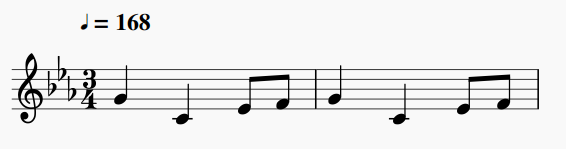

Composição RNN:

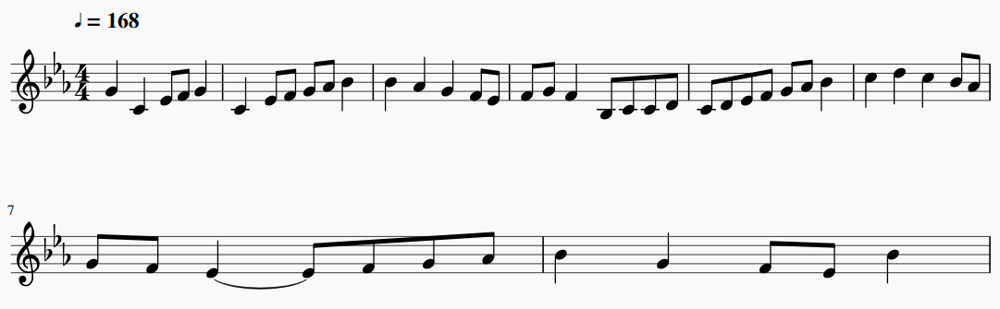

Acompanhamento Transformer:

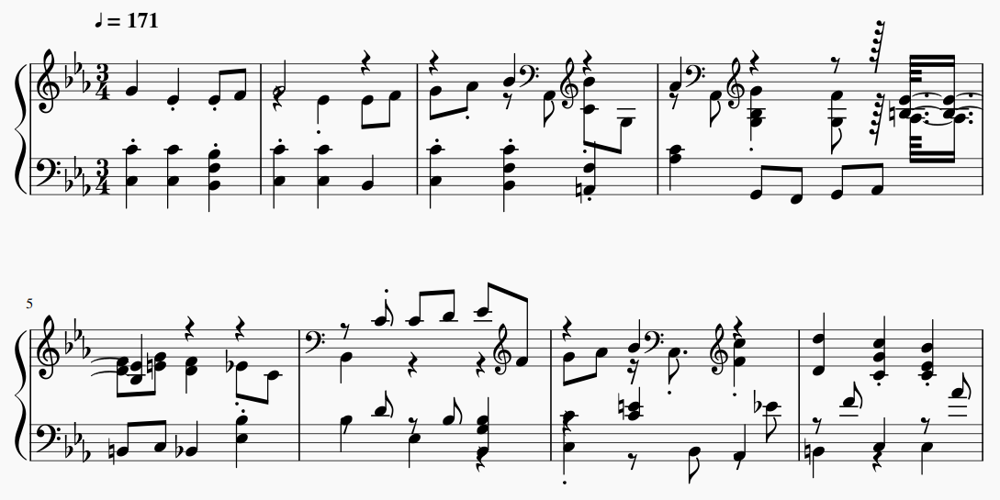

In [ ]:
input, SR=librosa.load('input.wav', sr=None, mono=True)

In [ ]:
input

array([0.        , 0.        , 0.        , ..., 0.00149536, 0.00164795,
       0.00186157], dtype=float32)

In [ ]:
output, SR=librosa.load('output.wav', sr=None, mono=True)

In [ ]:
output

array([0.        , 0.        , 0.        , ..., 0.00236511, 0.00158691,
       0.00067139], dtype=float32)

In [ ]:
output2, SR=librosa.load('output2.wav', sr=None, mono=True)

In [ ]:
output2

array([0.        , 0.        , 0.        , ..., 0.00352478, 0.00349426,
       0.00338745], dtype=float32)

In [ ]:
inputdf = pd.DataFrame(input,columns=['Data'])
outputdf = pd.DataFrame(output,columns=['Data'])

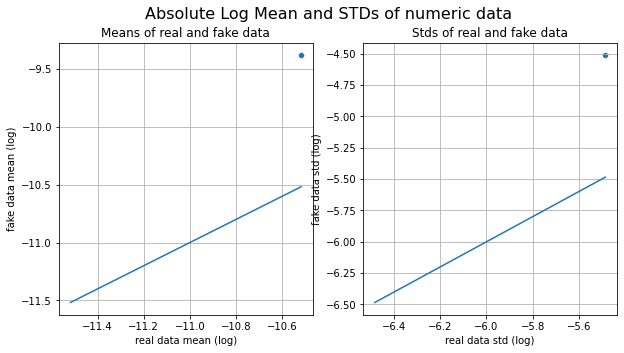

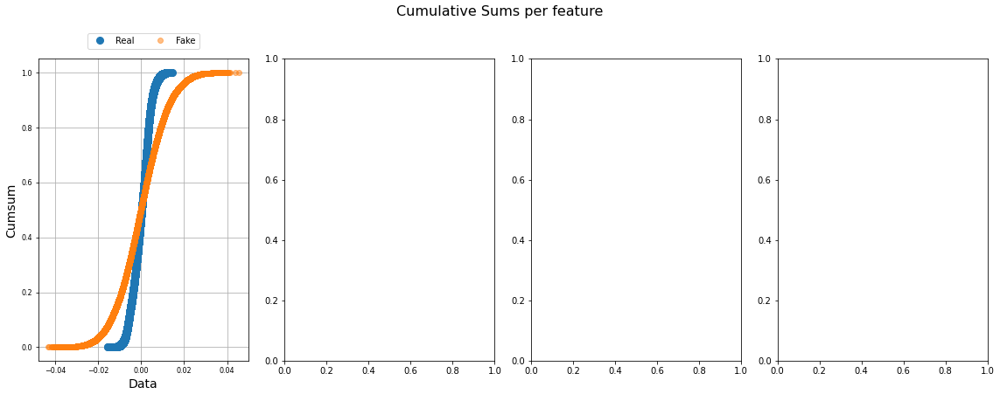

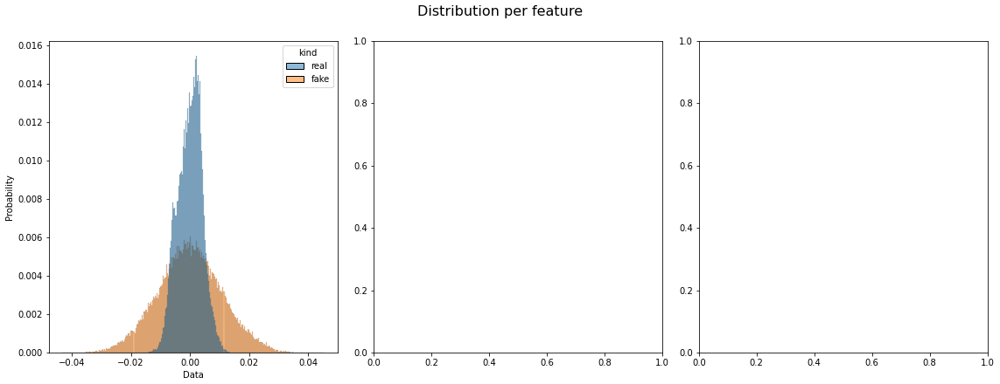

In [ ]:
evaluate(outputdf, inputdf, metrics=['KSTest'], aggregate=False)

,metric,name,raw_score,normalized_score,min_value,max_value,goal,error
0,KSTest,Inverted Kolmogorov-Smirnov D statistic,0.778064,0.778064,0.0,1.0,MAXIMIZE,None


In [ ]:
%matplotlib inline  
import matplotlib.pyplot as plt 
import numpy as np 
import librosa 
import librosa.display 
import librosa.feature
import seaborn as sns
import matplotlib as mpl
import scipy
from scipy import signal
from scipy.signal import find_peaks

In [ ]:
sns.set(rc={
 'axes.axisbelow': False,
 'axes.edgecolor': 'lightgrey',
 'axes.facecolor': 'None',
 'axes.grid': False,
 'axes.labelcolor': 'black',
 'axes.spines.right': False,
 'axes.spines.top': False,
 'figure.facecolor': 'white',
 'lines.solid_capstyle': 'round',
 'patch.edgecolor': 'w',
 'patch.force_edgecolor': True,
 'text.color': 'black',
 'xtick.bottom': True,
 'xtick.color': 'black',
 'xtick.direction': 'out',
 'xtick.top': False,
 'ytick.color': 'black',
 'ytick.direction': 'out',
 'ytick.left': False,
 'ytick.right': False})
 
sns.set_context("notebook", rc={"font.size":20,
                                "axes.titlesize":24,
                                "axes.labelsize":18})

In [ ]:
def mir(real : np.ndarray, sintetizado : np.ndarray, SR : int,
        pico_min_real: int = None, pico_min_sintetizado: int = None):

    if pico_min_real == None:
        pico_min_real = 100
    else:
        pico_min_real = pico_min_real

    if pico_min_sintetizado == None:
        pico_min_sintetizado = 100
    else:
        pico_min_sintetizado = pico_min_sintetizado
       
    #SR = sample rate
    audios =  [real,sintetizado]
    saves = ['Real','Sintetizado']
    picos = [pico_min_real, pico_min_sintetizado]
    figs = []

    for i in range(len(audios)):
        
        # Áudio

        audio = plt.figure(figsize=(10, 5))
        t = np.arange(len(audios[i]))/SR
        plt.title('Áudio '+saves[i])
        plt.xlabel('Tempo (s)')
        plt.ylabel('Amplitude')
        plt.minorticks_on()
        plt.plot(t,audios[i])
        plt.tight_layout()
        plt.savefig('/content/drive/MyDrive/figs/'+'Audio_'+ saves[i] + '.png', format='png')
        plt.show()
        figs.append(audio)

        #Feature 01 - STFT

        stft = plt.figure(figsize=(10, 5))
        Y = np.fft.fft(audios[i]) 
        freq = np.abs((np.fft.fftfreq(audios[i].size, d=1/SR)))
        mag= np.abs(Y)
        a1, pico = scipy.signal.find_peaks(mag,height=picos[i])
        plt.plot(freq, mag)
        plt.title('STFT Áudio '+ saves[i]) 
        plt.xlabel('Frequência (Hz)')
        plt.xlim([0, freq[a1].max()+250])
        plt.ylim([0, mag[a1].max()+250])

        for x,y in zip(freq[a1],list(pico.values())[0]):
            label = "{:.2f}".format(x),"{:.2f}".format(y)
            plt.annotate(label,
                 (x,y), 
                 textcoords="offset points", 
                 xytext=(0,10),
                 fontsize=10,
                 ha='center') 
            
        plt.ylabel('Magnitude')
        plt.minorticks_on()
        plt.tight_layout()
        plt.savefig('/content/drive/MyDrive/figs/'+'STFT_'+ saves[i] + '.png', format='png')
        plt.show()
        figs.append(stft)

        #Feature 02 : Espectrograma

        espec = plt.figure(figsize=(15, 10))
        D = librosa.stft(audios[i])
        rp = np.max(np.abs(D))
        plt.subplot(3, 1, 1)
        librosa.display.specshow(librosa.amplitude_to_db(np.abs(D), ref=rp), 
                                 y_axis='log', x_axis='time')
        plt.colorbar()
        plt.title('Espectrograma Áudio '+ saves[i])
        plt.xlabel('Tempo (s)')
        plt.ylabel('Frequência (Hz)')
        plt.minorticks_on()
        plt.tight_layout()
        plt.savefig('/content/drive/MyDrive/figs/'+'Espectro_'+ saves[i] + '.png', format='png')
        plt.show()
        figs.append(espec)

        #Feature 03 : Cromagrama

        chroma = plt.figure(figsize=(15, 10))
        S = np.abs(librosa.stft(audios[i], n_fft=4096))**2
        ch = librosa.feature.chroma_stft(S=S, sr=SR)
        plt.subplot(3, 1, 1)
        librosa.display.specshow(ch, y_axis='chroma', x_axis='time')
        plt.colorbar()
        plt.title('Cromagrama Áudio '+ saves[i])
        plt.xlabel('Tempo (s)')
        plt.ylabel('Classe de Afinação')
        plt.minorticks_on()
        plt.tight_layout()
        plt.savefig('/content/drive/MyDrive/figs/'+'Croma_'+ saves[i] + '.png', format='png')
        plt.show()
        figs.append(chroma)

        #Feature 04 : Mel Espectrograma

        melspec = plt.figure(figsize=(15, 4))
        D1 = np.abs(librosa.stft(audios[i]))**2
        S1 = librosa.feature.melspectrogram(S=D1)
        librosa.display.specshow(librosa.power_to_db(S1,ref=rp),y_axis='mel',
                                 fmax=8000,x_axis='time')
        plt.colorbar()
        plt.title('Mel Espectrograma Áudio ' + saves[i])
        plt.xlabel('Tempo (s)')
        plt.ylabel('Frequência (Hz)')
        plt.minorticks_on()
        plt.tight_layout()
        plt.savefig('/content/drive/MyDrive/figs/'+'Melspec_'+ saves[i] + '.png', format='png')
        plt.show()
        figs.append(melspec)

        #Feature 05 : MFCC

        mfcc = plt.figure(figsize=(15, 10))
        mfccs1 = librosa.feature.mfcc(y=audios[i], sr=SR, n_mfcc=40)
        plt.subplot(3, 1, 1)
        librosa.display.specshow(mfccs1,x_axis='time')
        plt.colorbar()
        plt.title('MFCC Áudio ' + saves[i])
        plt.xlabel('Tempo (s)')
        plt.ylabel('MFCC Coeficientes')
        plt.minorticks_on()
        plt.tight_layout()
        plt.savefig('/content/drive/MyDrive/figs/'+'MFCC_'+ saves[i] + '.png', format='png')
        plt.show()
        figs.append(mfcc)

    #Feature 06 : RMS

    rms = plt.figure(figsize=(10, 5))
    rms1 = librosa.feature.rms(y=audios[0])
    rms2 = librosa.feature.rms(y=audios[1])
    ax = rms.add_subplot(111)
    ax.plot(rms1.T, label = 'Real')
    ax2 = ax.twinx()
    ax2.plot(rms2.T,color = 'r', label = 'Sintetizado')
    plt.title('RMS dos Áudios')
    ax.set_ylabel(r'RMS - Real')
    ax2.set_ylabel(r'RMS - Sintetizado')
    rms.legend()
    plt.tight_layout()
    plt.minorticks_on()
    plt.savefig('/content/drive/MyDrive/figs/'+'RMS_'+ saves[i] + '.png', format='png')
    plt.show()
    figs.append(rms)

    #Feature 07 : Espectral Bandwith

    band = plt.figure(figsize=(10, 5))
    bw1 = librosa.feature.spectral_bandwidth(y=audios[0], sr=SR)
    bw2 = librosa.feature.spectral_bandwidth(y=audios[1], sr=SR)
    plt.title('Espectral Bandwidth dos Áudios')
    ax = band.add_subplot(111)
    ax.plot(bw1.T, label = 'Real')
    ax2 = ax.twinx()
    ax2.plot(bw2.T, color = 'r', label = 'Sintetizado')
    plt.xlabel('Frequência (Hz)')
    ax.set_ylabel(r'Freq Bandwith (Hz) - Real')  
    ax2.set_ylabel(r'Freq Bandwith (Hz) - Sint.')  
    band.legend()
    plt.minorticks_on()
    plt.tight_layout()
    plt.savefig('/content/drive/MyDrive/figs/'+'Bandw_'+ saves[i] + '.png', format='png')
    plt.show()
    figs.append(band)
 
    #Feature 08 : Espectral Rolloff

    roll = plt.figure(figsize=(10, 5))
    rolloff1 = librosa.feature.spectral_rolloff(y=audios[0], sr=SR)
    rolloff2 = librosa.feature.spectral_rolloff(y=audios[1], sr=SR)
    plt.title('Espectral Rolloff dos Áudios')
    ax = roll.add_subplot(111)
    ax.plot(rolloff1.T, label = 'Real') 
    ax2 = ax.twinx()
    ax2.plot(rolloff2.T, color = 'r', label = 'Sintetizado') 
    plt.xlabel('Frequência (Hz)')
    ax.set_ylabel(r'Freq Rolloff (Hz) - Real')  
    ax2.set_ylabel(r'Freq Rolloff (Hz) - Sint.') 
    roll.legend()
    plt.minorticks_on()
    plt.tight_layout()
    plt.savefig('/content/drive/MyDrive/figs/'+'Rolloff_'+ saves[i] + '.png', format='png')
    plt.show()
    figs.append(roll)

    #Feature 09 : Espectral Flatness

    flatness = plt.figure(figsize=(10, 5))
    flatness1 = librosa.feature.spectral_flatness(y=audios[0])
    flatness2 = librosa.feature.spectral_flatness(y=audios[1])
    plt.title('Espectral Flatness dos Áudios')
    ax = flatness.add_subplot(111)
    plt.plot(flatness1.T, label = 'Real')
    ax2 = ax.twinx()
    ax2.plot(flatness2.T, color = 'r', label = 'Sintetizado')  
    plt.xlabel('Frequência (Hz)')
    ax.set_ylabel(r'Flatness - Real') 
    ax2.set_ylabel(r'Flatness - Sintetizado')   
    flatness.legend()
    plt.minorticks_on()
    plt.tight_layout()
    plt.savefig('/content/drive/MyDrive/figs/'+'flatness_'+ saves[i] + '.png', format='png')
    plt.show()
    figs.append(flatness)

    #Feature 10 : Zero Crossing Rate

    zero = plt.figure(figsize=(10, 5))
    zero1 = librosa.feature.zero_crossing_rate(y=audios[0])
    zero2 = librosa.feature.zero_crossing_rate(y=audios[1])
    plt.title('Zero Crossing Rate dos Áudios')
    ax = zero.add_subplot(111)
    ax.plot(zero1.T, label = 'Real')
    ax2 = ax.twinx()
    ax2.plot(zero2.T, color = 'r', label = 'Sintetizado') 
    plt.xlabel('Frequência (Hz)')
    ax.set_ylabel(r'ZCR - Real')  
    ax2.set_ylabel(r'ZCR - Sintetizado')  
    zero.legend()
    plt.minorticks_on()
    plt.tight_layout()
    plt.savefig('/content/drive/MyDrive/figs/'+'Zero_'+ saves[i] + '.png', format='png')
    plt.show()
    figs.append(zero) 

    return figs

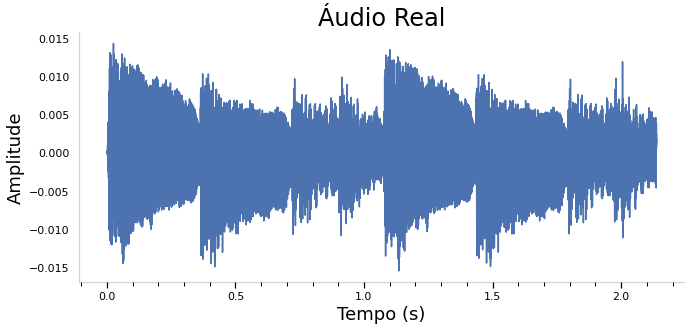

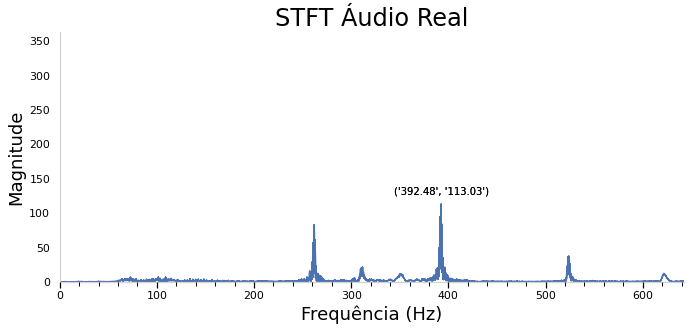

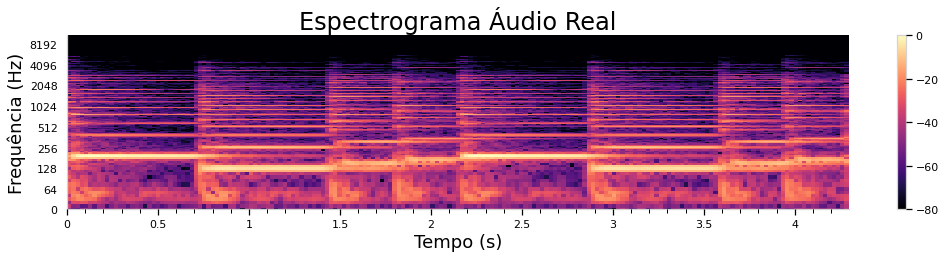

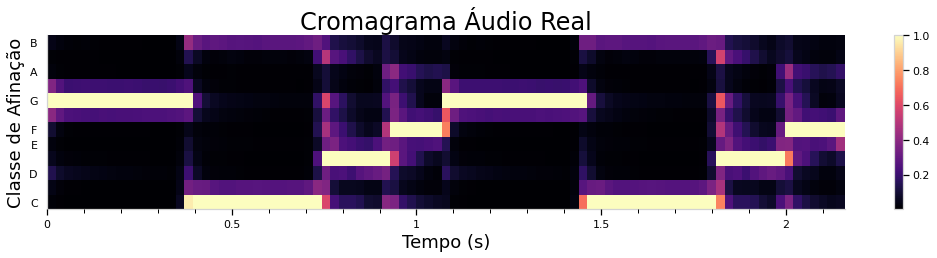

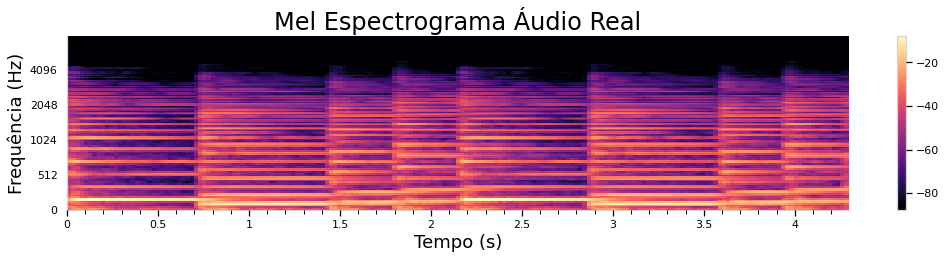

...

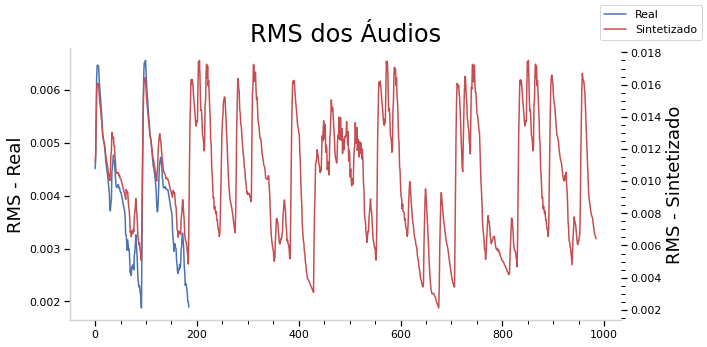

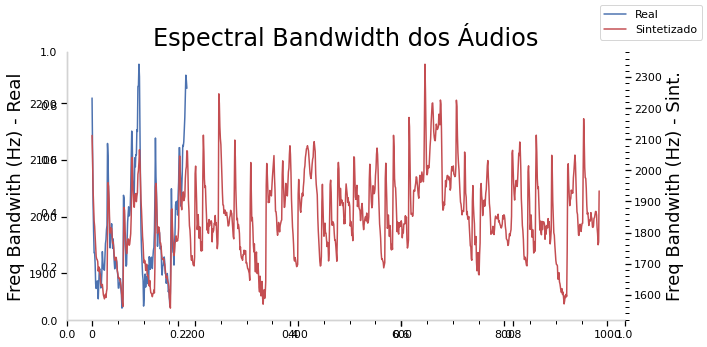

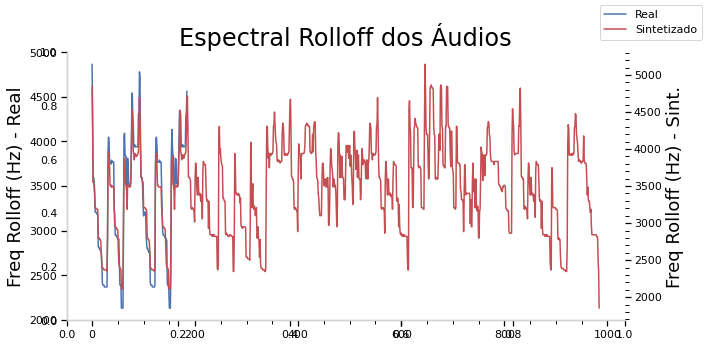

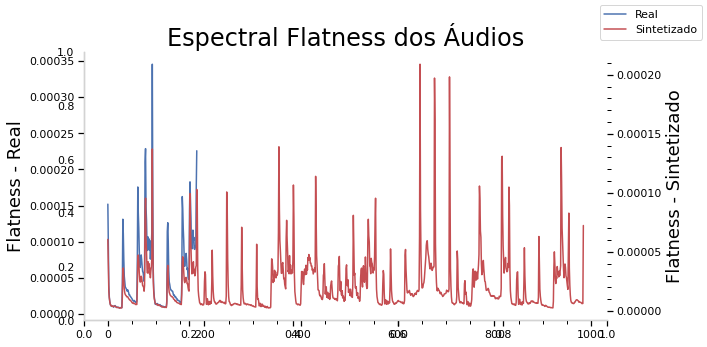

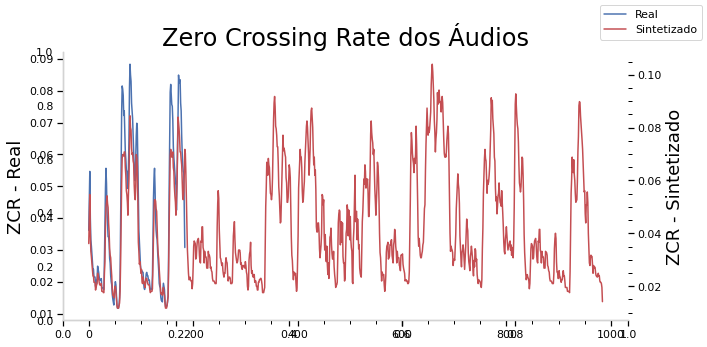

In [ ]:
a = mir(input,output,SR,pico_min_real=100,pico_min_sintetizado=900)

In [ ]:
!python midi_to_csv.py output

Outputting csv files in to output-output-csvs
Processing unconditional.mid in to unconditional.csv
Processing Game_of_Thrones_Melody_Monophonic.mid in to Game_of_Thrones_Melody_Monophonic.csv
Processing teste01.mid in to teste01.csv
Done creating csvs!


In [ ]:
real_treino = pd.read_csv('/content/output-output-csvs/teste01.csv')

In [ ]:
real_treino = real_treino.drop(['Unnamed: 0'],axis=1)

In [ ]:
ctgan = CTGAN(epochs=40, batch_size=500, generator_dim=(256, 256), discriminator_dim=(256, 256), generator_lr=0.0002, discriminator_lr=0.0002, verbose=True)
ctgan.fit(real_treino)

Epoch 1, Loss G:  2.3556,Loss D:  0.0082
Epoch 2, Loss G:  2.4021,Loss D:  0.0068
Epoch 3, Loss G:  2.3320,Loss D: -0.0084
Epoch 4, Loss G:  2.3314,Loss D:  0.0093
Epoch 5, Loss G:  2.3218,Loss D: -0.0066
Epoch 6, Loss G:  2.2757,Loss D:  0.0137
Epoch 7, Loss G:  2.2190,Loss D:  0.0022
Epoch 8, Loss G:  2.2748,Loss D: -0.0052
Epoch 9, Loss G:  2.2478,Loss D:  0.0058
Epoch 10, Loss G:  2.2493,Loss D: -0.0338
Epoch 11, Loss G:  2.1927,Loss D:  0.0293
Epoch 12, Loss G:  2.2044,Loss D: -0.0240
Epoch 13, Loss G:  2.1749,Loss D: -0.0069
Epoch 14, Loss G:  2.1501,Loss D: -0.0308
Epoch 15, Loss G:  2.1698,Loss D: -0.0067
Epoch 16, Loss G:  2.0904,Loss D: -0.0317
Epoch 17, Loss G:  2.1179,Loss D: -0.0374
Epoch 18, Loss G:  2.1729,Loss D: -0.0936
Epoch 19, Loss G:  2.0675,Loss D: -0.0559
Epoch 20, Loss G:  2.0684,Loss D: -0.0477
Epoch 21, Loss G:  2.0360,Loss D: -0.0787
Epoch 22, Loss G:  2.0974,Loss D:  0.0088
Epoch 23, Loss G:  1.9949,Loss D: -0.0362
Epoch 24, Loss G:  2.0039,Loss D: -0.0193
E

In [ ]:
fake = ctgan.sample(100)
fake1 = ctgan.sample(200)
fake2 = ctgan.sample(400)
fake3 = ctgan.sample(800)
fake4 = ctgan.sample(1200)

In [ ]:
fake

,note_name,start_time,duration,velocity,tempo
0,C4,31.0,0.6,100,168.0
1,E-4,13.4,0.6,100,168.0
2,E-4,25.8,0.5,100,168.0
3,C4,25.7,0.5,100,168.0
4,G#4,29.4,0.6,100,168.0
...,...,...,...,...,...
95,G#4,21.9,0.6,100,168.0
96,G#4,24.8,0.5,100,168.0
97,C4,31.0,0.5,100,168.0
98,D4,29.4,0.5,100,168.0


In [ ]:
!mkdir teste3

In [ ]:
fake.to_csv('teste3/teste.csv')
fake1.to_csv('teste3/teste1.csv')
fake2.to_csv('teste3/teste2.csv')
fake3.to_csv('teste3/teste3.csv')
fake4.to_csv('teste3/teste4.csv')

In [ ]:
!python csv_to_midi.py teste3

Outputting mid files in to teste3-output-midis
Processing teste1.csv in to teste1.mid
Processing teste3.csv in to teste3.mid
Processing teste.csv in to teste.mid
Processing teste4.csv in to teste4.mid
Processing teste2.csv in to teste2.mid
Done creating midis!


In [ ]:
!mkdir output2

In [ ]:
archives = os.listdir('/content/teste3-output-midis')

In [ ]:
for i in range(len(archives)):
  fs.midi_to_audio('/content/teste3-output-midis/'+archives[i], 'output2/' + 'audio0{0}'.format(i) +'.wav') 

In [ ]:
audios = os.listdir('output2')

In [ ]:
wave = []
for audio in audios:
  s = Audio('output2/' + audio)
  wave.append(s)

In [ ]:
for i in range(len(wave)):
  print('audio0{0}'.format(i),'\n')
  display(wave[i])
  print('\n')

audio00 





audio01 





audio02 





audio03 





audio04 

